# Lab13-2: Denoising Diffusion Probabilistic Model
---
111062117 黃祥陞

In this assignment, you have to implement the DDIMs.

## 0. Setup

In [13]:
import math
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf

from tensorflow import keras
from tensorflow.keras import layers

import tensorflow_addons as tfa
import tensorflow_datasets as tfds 

In [14]:
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        # Restrict TensorFlow to only use the first GPU
        tf.config.experimental.set_visible_devices(gpus[0], 'GPU')

        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)
    

## 1. Hyperparameters

In [15]:
# Feel free to change these parameters according to your system's configuration
# data
dataset_name = "oxford_flowers102"
dataset_repetitions = 1
num_epochs = 60
image_size = 64
suffle_times = 10

# KID = Kernel Inception Distance, see related section
kid_image_size = 75
kid_diffusion_steps = 5
plot_diffusion_steps = 20

# sampling
min_signal_rate = 0.02
max_signal_rate = 0.95

# architecture
embedding_dims = 32
embedding_max_frequency = 1000.0
widths = [32, 64, 96, 128]
block_depth = 2

# optimization
batch_size = 32
ema = 0.999
learning_rate = 1e-3
weight_decay = 1e-4

## 2. Data pipeline

In [16]:
def preprocess_image(data):
    # center crop image
    height = tf.shape(data["image"])[0]
    width = tf.shape(data["image"])[1]
    crop_size = tf.minimum(height, width)
    image = tf.image.crop_to_bounding_box(
        data["image"],
        (height - crop_size) // 2,
        (width - crop_size) // 2,
        crop_size,
        crop_size,
    )

    # resize and clip
    # for image downsampling it is important to turn on antialiasing
    image = tf.image.resize(image, size=[image_size, image_size], antialias=True)
    return tf.clip_by_value(image / 255.0, 0.0, 1.0)


def prepare_dataset(split):
    # the validation dataset is shuffled as well, because data order matters
    # for the KID estimation
    return (
        tfds.load(dataset_name, split=split, shuffle_files=True)
        .map(preprocess_image, num_parallel_calls=tf.data.AUTOTUNE)
        .cache()
        .repeat(dataset_repetitions)
        .shuffle(suffle_times * batch_size)
        .batch(batch_size, drop_remainder=True)
        .prefetch(buffer_size=tf.data.AUTOTUNE)
    )


# Load individual datasets
train_part = prepare_dataset("train")
validation_part = prepare_dataset("validation")
test_part = prepare_dataset("test")

# Concatenate all parts into one training dataset
train_dataset = train_part.concatenate(test_part)
val_dataset = validation_part

## 3. Kernel inception distance
Kernel Inception Distance (KID) is an image quality metric developed as a simpler and computationally lighter alternative to the popular Frechet Inception Distance (FID).

In this example, the images are evaluated at a lower resolution compatible with the Inception network (75x75 instead of the usual 299x299), and the metric is computed only on the validation set to save on computational cost. Additionally, we restrict the number of sampling steps during evaluation to 5 for efficiency.

Since the dataset is relatively small, we repeat the training and validation splits multiple times within each epoch. This approach helps to mitigate the noise in KID estimation, which is compute-intensive, by ensuring the metric is evaluated after accumulating a substantial number of iterations, providing a more reliable measurement.

In [17]:
class KID(keras.metrics.Metric):
    def __init__(self, name, **kwargs):
        super().__init__(name=name, **kwargs)

        # KID is estimated per batch and is averaged across batches
        self.kid_tracker = keras.metrics.Mean(name="kid_tracker")

        # a pretrained InceptionV3 is used without its classification layer
        # transform the pixel values to the 0-255 range, then use the same
        # preprocessing as during pretraining
        self.encoder = keras.Sequential(
            [
                keras.Input(shape=(image_size, image_size, 3)),
                layers.Rescaling(255.0),
                layers.Resizing(height=kid_image_size, width=kid_image_size),
                layers.Lambda(keras.applications.inception_v3.preprocess_input),
                keras.applications.InceptionV3(
                    include_top=False,
                    input_shape=(kid_image_size, kid_image_size, 3),
                    weights="imagenet",
                ),
                layers.GlobalAveragePooling2D(),
            ],
            name="inception_encoder",
        )

    def polynomial_kernel(self, features_1, features_2):
        # Use TensorFlow functions instead of ops
        feature_dimensions = tf.cast(tf.shape(features_1)[1], dtype="float32")
        return (tf.matmul(features_1, tf.transpose(features_2)) / feature_dimensions + 1.0) ** 3.0

    def update_state(self, real_images, generated_images, sample_weight=None):
        real_features = self.encoder(real_images, training=False)
        generated_features = self.encoder(generated_images, training=False)

        # compute polynomial kernels using the two sets of features
        kernel_real = self.polynomial_kernel(real_features, real_features)
        kernel_generated = self.polynomial_kernel(generated_features, generated_features)
        kernel_cross = self.polynomial_kernel(real_features, generated_features)

        # estimate the squared maximum mean discrepancy using the average kernel values
        batch_size = tf.shape(real_features)[0]
        batch_size_f = tf.cast(batch_size, dtype="float32")
        mean_kernel_real = tf.reduce_sum(kernel_real * (1.0 - tf.eye(batch_size))) / (
            batch_size_f * (batch_size_f - 1.0)
        )
        mean_kernel_generated = tf.reduce_sum(kernel_generated * (1.0 - tf.eye(batch_size))) / (
            batch_size_f * (batch_size_f - 1.0)
        )
        mean_kernel_cross = tf.reduce_mean(kernel_cross)
        kid = mean_kernel_real + mean_kernel_generated - 2.0 * mean_kernel_cross

        # update the average KID estimate
        self.kid_tracker.update_state(kid)

    def result(self):
        return self.kid_tracker.result()

    def reset_state(self):
        self.kid_tracker.reset_state()

## 4. Network architecture
The DDIM network architecture is based on a modified U-Net, tailored specifically for efficient and deterministic image generation through diffusion. Here are some key design choices that differentiate it from other diffusion models like DDPM:

1. Continuous Time Embedding: The network includes a sinusoidal time embedding that enables continuous representation of the diffusion time. This continuous approach allows DDIM to modify sampling steps flexibly during inference, a significant departure from the discrete time steps in DDPM.
2. Deterministic Reverse Diffusion: Unlike DDPM, which uses random noise in each step, DDIM is designed to follow a deterministic reverse process. This change ensures faster generation speeds and consistent outputs under the same conditions, providing better control over the generated images.
3. Group Normalization and Swish Activation: Similar to other diffusion models, DDIM utilizes group normalization for stability and the Swish activation function across layers. These are chosen to enhance the model's capacity to handle complex data while maintaining efficient training.
4. Reduced Sampling Steps: By adjusting the denoising steps, DDIM achieves faster image generation, as it can effectively use fewer steps compared to DDPM, making it suitable for applications where speed is essential.

These adjustments allow DDIM to strike a balance between performance and efficiency, making it more suitable for high-speed and deterministic generation applications.

In [18]:
def sinusoidal_embedding(x):
    embedding_min_frequency = 1.0
    frequencies = tf.math.exp(
        tf.linspace(
            tf.math.log(embedding_min_frequency),
            tf.math.log(embedding_max_frequency),
            embedding_dims // 2,
        )
    )
    angular_speeds = tf.cast(2.0 * math.pi * frequencies, "float32")
    embeddings = tf.concat(
        [tf.sin(angular_speeds * x), tf.cos(angular_speeds * x)], axis=3
    )
    return embeddings


def ResidualBlock(width):
    def apply(x):
        input_width = x.shape[3]
        if input_width == width:
            residual = x
        else:
            residual = layers.Conv2D(width, kernel_size=1)(x)
        x = layers.BatchNormalization(center=False, scale=False)(x)
        x = layers.Conv2D(width, kernel_size=3, padding="same", activation="swish")(x)
        x = layers.Conv2D(width, kernel_size=3, padding="same")(x)
        x = layers.Add()([x, residual])
        return x

    return apply


def DownBlock(width, block_depth):
    def apply(x):
        x, skips = x
        for _ in range(block_depth):
            x = ResidualBlock(width)(x)
            skips.append(x)
        x = layers.AveragePooling2D(pool_size=2)(x)
        return x

    return apply


def UpBlock(width, block_depth):
    def apply(x):
        x, skips = x
        x = layers.UpSampling2D(size=2, interpolation="bilinear")(x)
        for _ in range(block_depth):
            x = layers.Concatenate()([x, skips.pop()])
            x = ResidualBlock(width)(x)
        return x

    return apply


def get_network(image_size, widths, block_depth):
    noisy_images = keras.Input(shape=(image_size, image_size, 3))
    noise_variances = keras.Input(shape=(1, 1, 1))

    e = layers.Lambda(sinusoidal_embedding, output_shape=(1, 1, 32))(noise_variances)
    e = layers.UpSampling2D(size=image_size, interpolation="nearest")(e)

    x = layers.Conv2D(widths[0], kernel_size=1)(noisy_images)
    x = layers.Concatenate()([x, e])

    skips = []
    for width in widths[:-1]:
        x = DownBlock(width, block_depth)([x, skips])

    for _ in range(block_depth):
        x = ResidualBlock(widths[-1])(x)

    for width in reversed(widths[:-1]):
        x = UpBlock(width, block_depth)([x, skips])

    x = layers.Conv2D(3, kernel_size=1, kernel_initializer="zeros")(x)

    return keras.Model([noisy_images, noise_variances], x, name="residual_unet")

## 5. Diffusion model

In [19]:
class DiffusionModel(keras.Model):
    def __init__(self, image_size, widths, block_depth):
        super().__init__()

        self.normalizer = layers.Normalization()
        self.network = get_network(image_size, widths, block_depth)
        self.ema_network = keras.models.clone_model(self.network)

    def compile(self, **kwargs):
        super().compile(**kwargs)

        self.noise_loss_tracker = keras.metrics.Mean(name="n_loss")
        self.image_loss_tracker = keras.metrics.Mean(name="i_loss")
        self.kid = KID(name="kid")

    @property
    def metrics(self):
        return [self.noise_loss_tracker, self.image_loss_tracker, self.kid]

    def denormalize(self, images):
        # convert the pixel values back to 0-1 range
        images = self.normalizer.mean + images * self.normalizer.variance**0.5
        return tf.clip_by_value(images, 0.0, 1.0)

    def diffusion_schedule(self, diffusion_times):
        # TODO: check if the diffusion_times are in the range [0, 1]
        # diffusion_times should be between 0 and 1, corresponding to the start and end of the diffusion process
        diffusion_times = tf.clip_by_value(diffusion_times, 0.0, 1.0)
        start_angle, end_angle = tf.acos(max_signal_rate), tf.acos(min_signal_rate)
        diffusion_times = start_angle + diffusion_times * (end_angle - start_angle)

        # Use cosine and sine functions to calculate the signal and noise rates based on angles
        signal_rates, noise_rates = tf.cos(diffusion_times), tf.sin(diffusion_times)
        # note that their squared sum is always: sin^2(x) + cos^2(x) = 1

        return noise_rates, signal_rates

    def denoise(self, noisy_images, noise_rates, signal_rates, training):
        # TODO: implement the denoising network
        # Use the model (self.network or self.ema_network) to predict the noise component in the images
        network = self.network if training else self.ema_network
       
        # Predict the noise component and calculate the image component using it
        # Here, use the signal_rate and noise_rate to derive the output components

        # pred_noises , pred_images = None, None #calculate the predicted noises and images
        pred_noises = network([noisy_images, noise_rates**2], training=training)
        pred_images = (noisy_images - noise_rates * pred_noises) / signal_rates
        return pred_noises, pred_images

    def reverse_diffusion(self, initial_noise, diffusion_steps):
        # reverse diffusion = sampling
        num_images = initial_noise.shape[0]
        step_size = 1.0 / diffusion_steps

        # important line:
        # at the first sampling step, the "noisy image" is pure noise
        # but its signal rate is assumed to be nonzero (min_signal_rate)
        next_noisy_images = initial_noise
        for step in range(diffusion_steps):
            # TODO: implement the reverse diffusion process
            # This process gradually reduces the noise to generate a clearer image
            noisy_image = next_noisy_images
            diffusion_times = tf.ones((num_images, 1, 1, 1)) - step * step_size
            noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
            pred_noises, pred_images = self.denoise(noisy_image, noise_rates, signal_rates, training=False)
            next_diffusion_times = diffusion_times - step_size
            next_noise_rates, next_signal_rates = self.diffusion_schedule(next_diffusion_times)
            next_noisy_images = next_signal_rates * pred_images + next_noise_rates * pred_noises

            # remix the predicted components
            # Use the signal_rate and noise_rate from the next step to recombine image and noise components
            
            # pred_noises, pred_images = None, None # network used in eval mode
            # next_noisy_images = None # remix the predicted components

        return pred_images

    def generate(self, num_images, diffusion_steps):
        # noise -> images -> denormalized images
        initial_noise = tf.random.normal(
            shape=(num_images, image_size, image_size, 3)
        )
        generated_images = self.reverse_diffusion(initial_noise, diffusion_steps)
        generated_images = self.denormalize(generated_images)
        return generated_images

    def train_step(self, images):
        # normalize images to have standard deviation of 1, like the noises
        images = self.normalizer(images, training=True)
        noises = tf.random.normal(shape=(batch_size, image_size, image_size, 3))

        # sample uniform random diffusion times
        diffusion_times = tf.random.uniform(
            shape=(batch_size, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        # mix the images with noises accordingly
        noisy_images = signal_rates * images + noise_rates * noises

        with tf.GradientTape() as tape:
            # train the network to separate noisy images to their components
            pred_noises, pred_images = self.denoise(
                noisy_images, noise_rates, signal_rates, training=True
            )

            noise_loss = self.loss(noises, pred_noises)  # used for training
            image_loss = self.loss(images, pred_images)  # only used as metric

        gradients = tape.gradient(noise_loss, self.network.trainable_weights)
        self.optimizer.apply_gradients(zip(gradients, self.network.trainable_weights))

        self.noise_loss_tracker.update_state(noise_loss)
        self.image_loss_tracker.update_state(image_loss)

        # track the exponential moving averages of weights
        for weight, ema_weight in zip(self.network.weights, self.ema_network.weights):
            ema_weight.assign(ema * ema_weight + (1 - ema) * weight)

        # KID is not measured during the training phase for computational efficiency
        return {m.name: m.result() for m in self.metrics[:-1]}

    def test_step(self, images):
        # normalize images to have standard deviation of 1, like the noises
        images = self.normalizer(images, training=False)
        noises = tf.random.normal(shape=(batch_size, image_size, image_size, 3))

        # sample uniform random diffusion times
        diffusion_times = tf.random.uniform(
            shape=(batch_size, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        # mix the images with noises accordingly
        noisy_images = signal_rates * images + noise_rates * noises

        # use the network to separate noisy images to their components
        pred_noises, pred_images = self.denoise(
            noisy_images, noise_rates, signal_rates, training=False
        )

        noise_loss = self.loss(noises, pred_noises)
        image_loss = self.loss(images, pred_images)

        self.image_loss_tracker.update_state(image_loss)
        self.noise_loss_tracker.update_state(noise_loss)

        # measure KID between real and generated images
        # this is computationally demanding, kid_diffusion_steps has to be small
        images = self.denormalize(images)
        generated_images = self.generate(
            num_images=batch_size, diffusion_steps=kid_diffusion_steps
        )
        self.kid.update_state(images, generated_images)

        return {m.name: m.result() for m in self.metrics}

    def plot_images(self, epoch=None, logs=None, num_rows=3, num_cols=6):
        # plot random generated images for visual evaluation of generation quality
        generated_images = self.generate(
            num_images=num_rows * num_cols,
            diffusion_steps=plot_diffusion_steps,
        )

        plt.figure(figsize=(num_cols * 2.0, num_rows * 2.0))
        for row in range(num_rows):
            for col in range(num_cols):
                index = row * num_cols + col
                plt.subplot(num_rows, num_cols, index + 1)
                plt.imshow(generated_images[index])
                plt.axis("off")
        plt.tight_layout()
        plt.show()
        plt.close()

## 6. Training

In [20]:
# create and compile the model
model = DiffusionModel(image_size, widths, block_depth)

In [21]:
model.compile(
    optimizer=tfa.optimizers.AdamW(
        learning_rate=learning_rate, weight_decay=weight_decay
    ),
    loss=keras.losses.mean_absolute_error,
)
# pixelwise mean absolute error is used as loss

In [22]:
# save the best model based on the validation KID metric
checkpoint_path = f"checkpoints/DDIM/tf_checkpoint"
checkpoint_callback = keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor="val_kid",
    mode="min",
    save_best_only=True,
)

In [23]:
# calculate mean and variance of training dataset for normalization
model.normalizer.adapt(train_dataset)

Epoch 1/60
223/223 [==============================] - ETA: 0s - n_loss: 0.2595 - i_loss: 0.5685

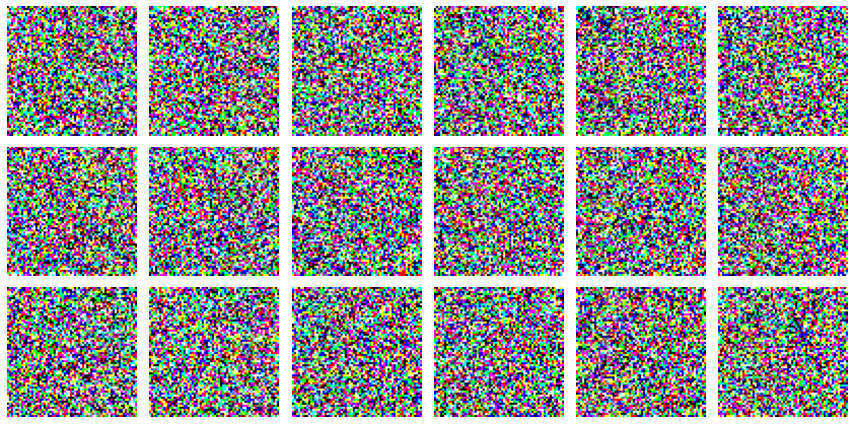

223/223 [==============================] - 415s 2s/step - n_loss: 0.2595 - i_loss: 0.5685 - val_n_loss: 0.7976 - val_i_loss: 2.6252 - val_kid: 2.0495
Epoch 2/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1890 - i_loss: 0.3428

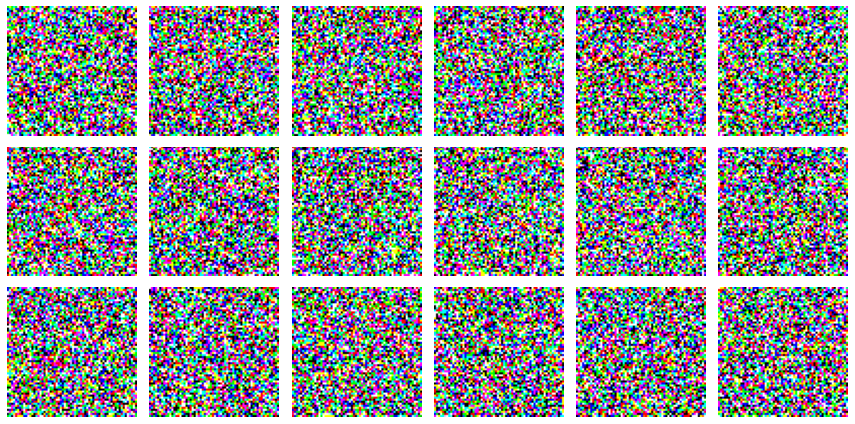

223/223 [==============================] - 414s 2s/step - n_loss: 0.1890 - i_loss: 0.3428 - val_n_loss: 0.7928 - val_i_loss: 2.4280 - val_kid: 1.9923
Epoch 3/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1802 - i_loss: 0.3160

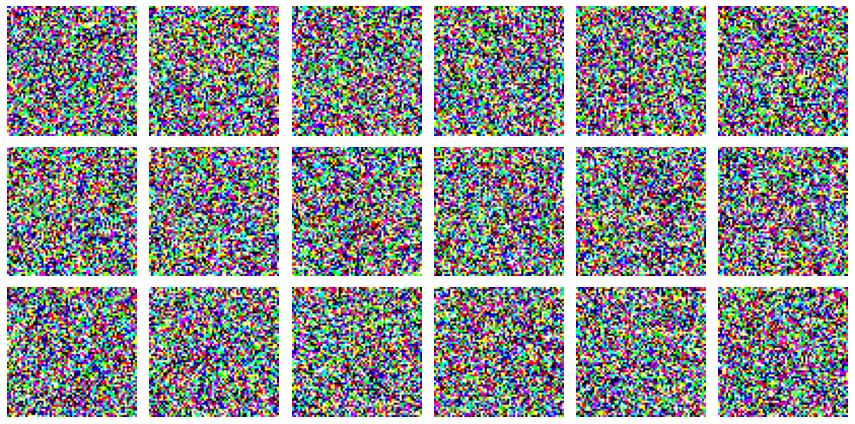

223/223 [==============================] - 398s 2s/step - n_loss: 0.1802 - i_loss: 0.3160 - val_n_loss: 0.7770 - val_i_loss: 2.6313 - val_kid: 2.0074
Epoch 4/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1712 - i_loss: 0.3067

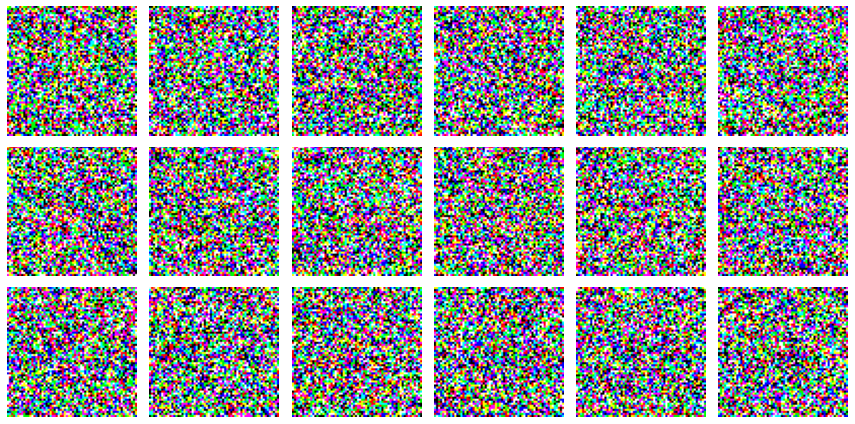

223/223 [==============================] - 411s 2s/step - n_loss: 0.1712 - i_loss: 0.3067 - val_n_loss: 0.7480 - val_i_loss: 2.4015 - val_kid: 1.9334
Epoch 5/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1692 - i_loss: 0.2879

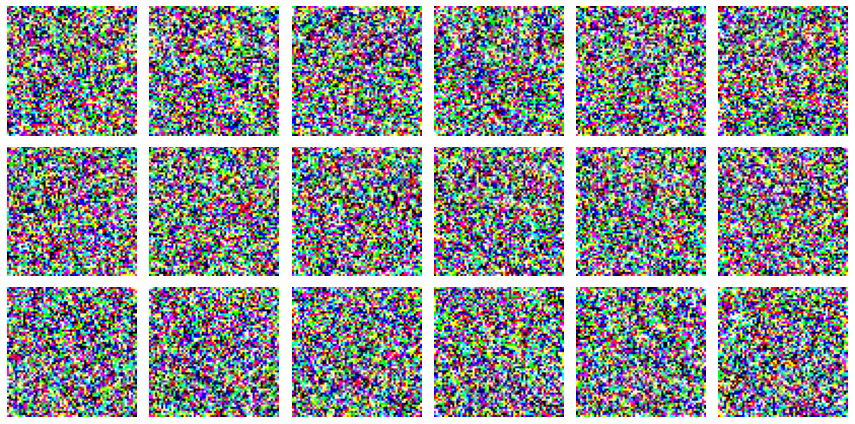

223/223 [==============================] - 406s 2s/step - n_loss: 0.1692 - i_loss: 0.2879 - val_n_loss: 0.7061 - val_i_loss: 2.1364 - val_kid: 1.9033
Epoch 6/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1640 - i_loss: 0.2837

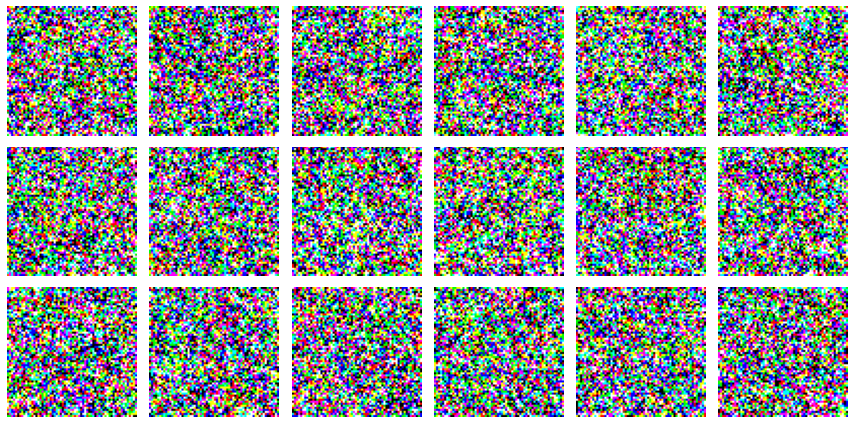

223/223 [==============================] - 391s 2s/step - n_loss: 0.1640 - i_loss: 0.2837 - val_n_loss: 0.6515 - val_i_loss: 1.9248 - val_kid: 1.7517
Epoch 7/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1631 - i_loss: 0.2798

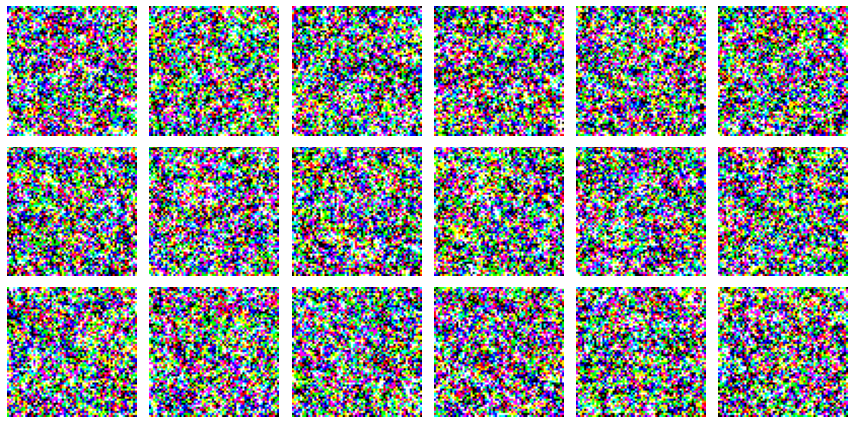

223/223 [==============================] - 410s 2s/step - n_loss: 0.1631 - i_loss: 0.2798 - val_n_loss: 0.5955 - val_i_loss: 1.6762 - val_kid: 1.6233
Epoch 8/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1612 - i_loss: 0.2739

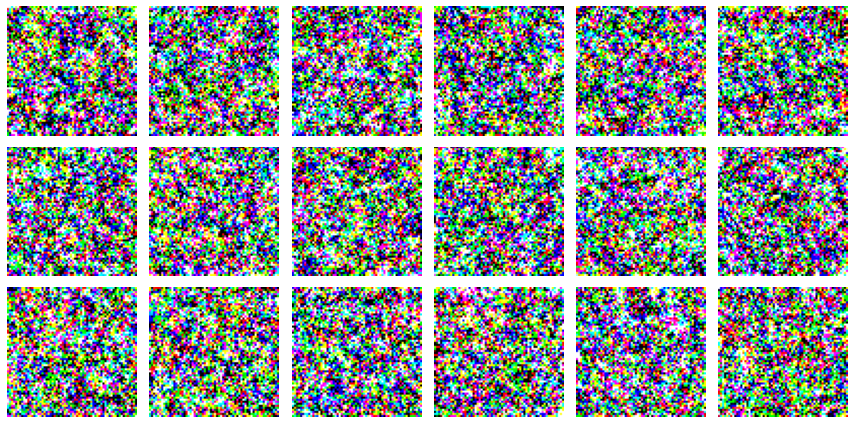

223/223 [==============================] - 416s 2s/step - n_loss: 0.1612 - i_loss: 0.2739 - val_n_loss: 0.5345 - val_i_loss: 1.4935 - val_kid: 1.4869
Epoch 9/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1616 - i_loss: 0.2735

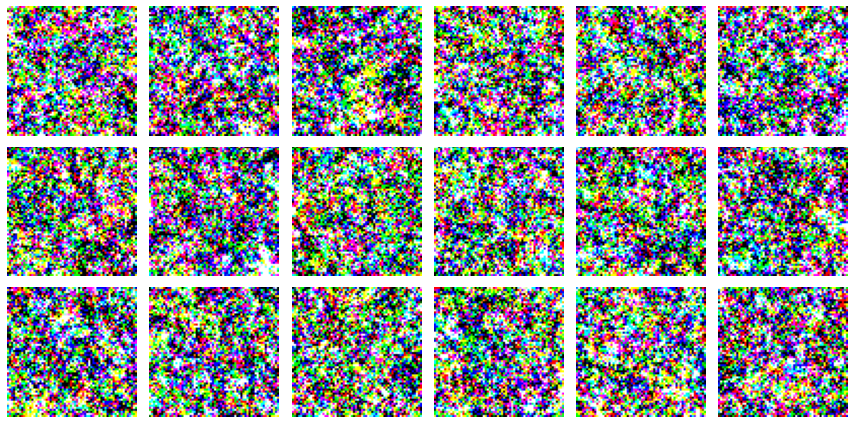

223/223 [==============================] - 410s 2s/step - n_loss: 0.1616 - i_loss: 0.2735 - val_n_loss: 0.4728 - val_i_loss: 1.4026 - val_kid: 1.3985
Epoch 10/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1586 - i_loss: 0.2717

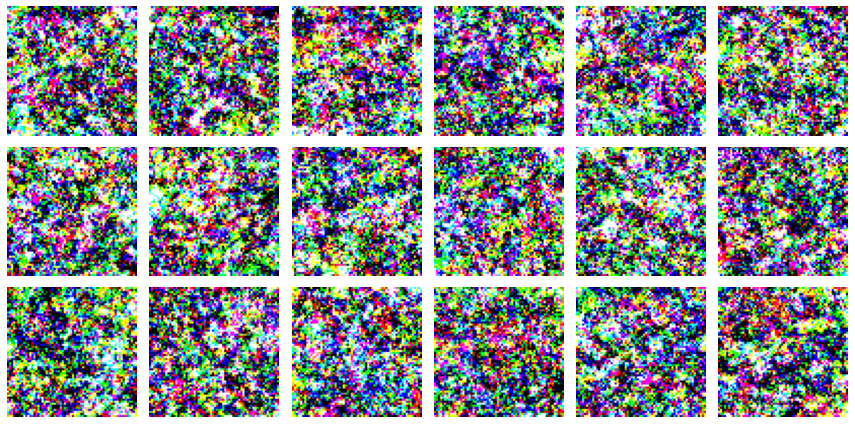

223/223 [==============================] - 409s 2s/step - n_loss: 0.1586 - i_loss: 0.2717 - val_n_loss: 0.4191 - val_i_loss: 1.2118 - val_kid: 1.3673
Epoch 11/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1588 - i_loss: 0.2722

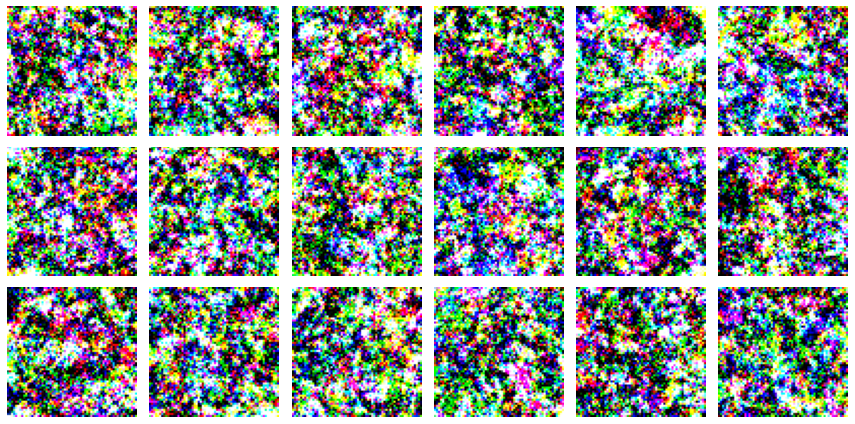

223/223 [==============================] - 409s 2s/step - n_loss: 0.1588 - i_loss: 0.2722 - val_n_loss: 0.3676 - val_i_loss: 1.0232 - val_kid: 1.4090
Epoch 12/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1571 - i_loss: 0.2666

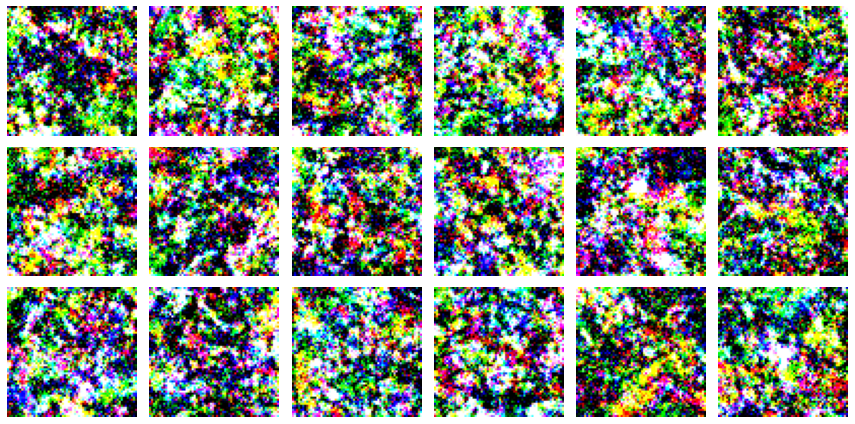

223/223 [==============================] - 409s 2s/step - n_loss: 0.1571 - i_loss: 0.2666 - val_n_loss: 0.3207 - val_i_loss: 0.8516 - val_kid: 1.4184
Epoch 13/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1575 - i_loss: 0.2701

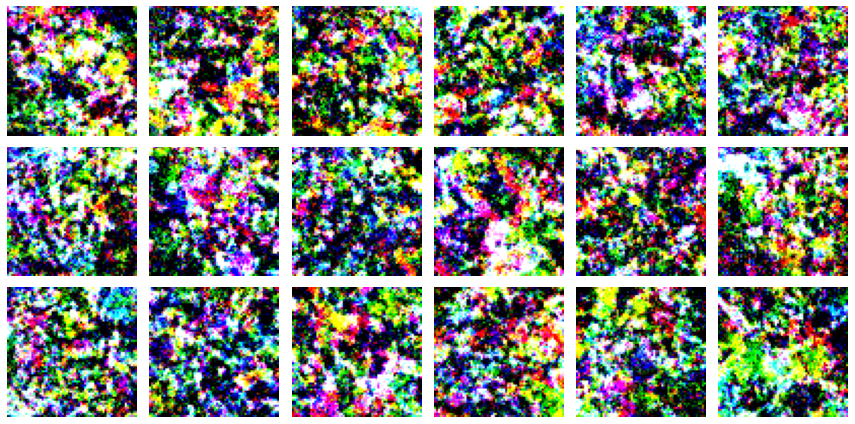

223/223 [==============================] - 411s 2s/step - n_loss: 0.1575 - i_loss: 0.2701 - val_n_loss: 0.2873 - val_i_loss: 0.7755 - val_kid: 1.4962
Epoch 14/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1569 - i_loss: 0.2651

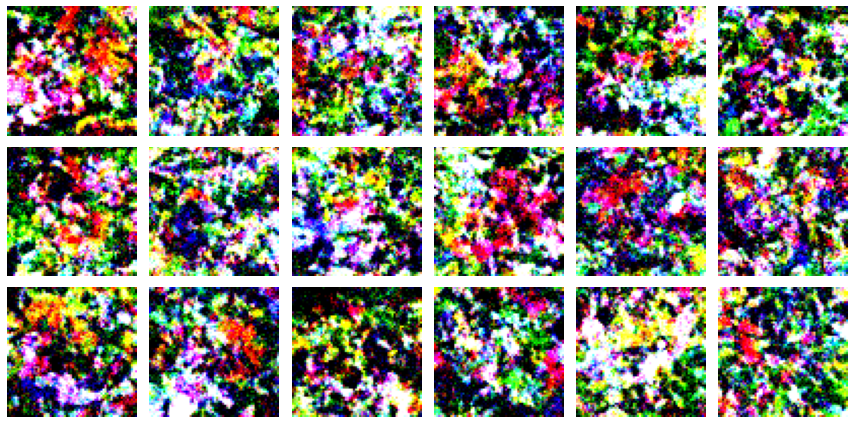

223/223 [==============================] - 411s 2s/step - n_loss: 0.1569 - i_loss: 0.2651 - val_n_loss: 0.2555 - val_i_loss: 0.6554 - val_kid: 1.5752
Epoch 15/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1553 - i_loss: 0.2680

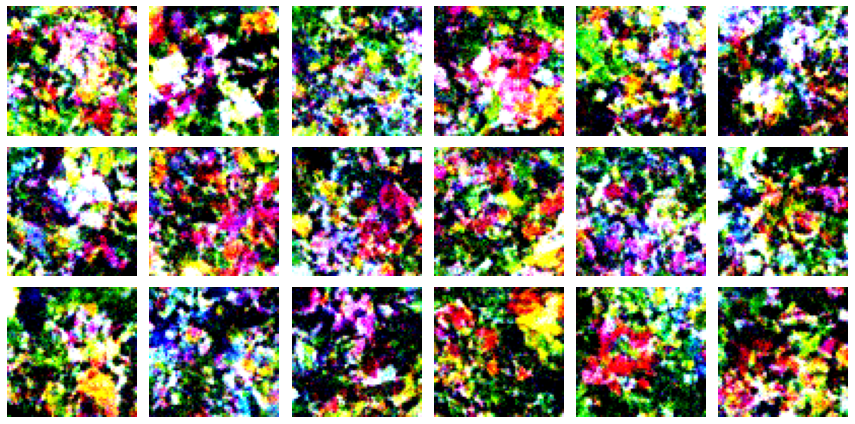

223/223 [==============================] - 413s 2s/step - n_loss: 0.1553 - i_loss: 0.2680 - val_n_loss: 0.2279 - val_i_loss: 0.5320 - val_kid: 1.4386
Epoch 16/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1535 - i_loss: 0.2691

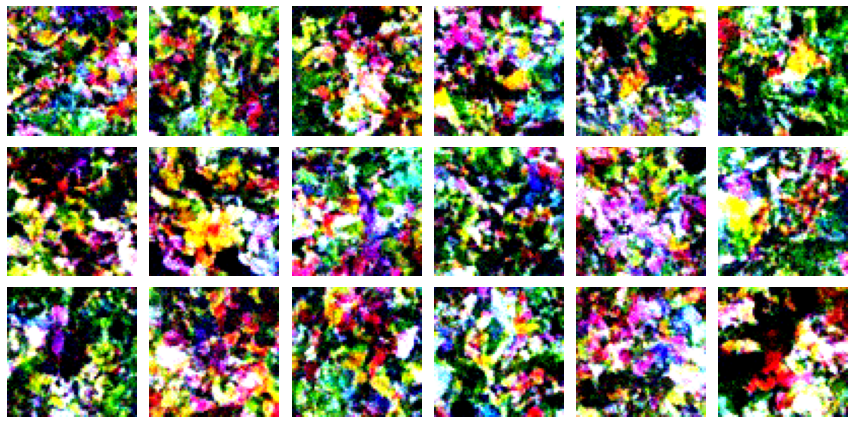

223/223 [==============================] - 404s 2s/step - n_loss: 0.1535 - i_loss: 0.2691 - val_n_loss: 0.2085 - val_i_loss: 0.4594 - val_kid: 1.2299
Epoch 17/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1559 - i_loss: 0.2597

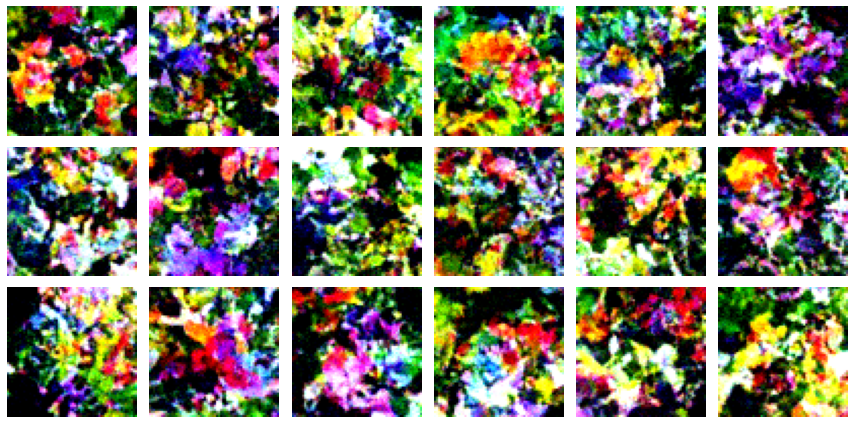

223/223 [==============================] - 418s 2s/step - n_loss: 0.1559 - i_loss: 0.2597 - val_n_loss: 0.1933 - val_i_loss: 0.4057 - val_kid: 1.0772
Epoch 18/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1539 - i_loss: 0.2670

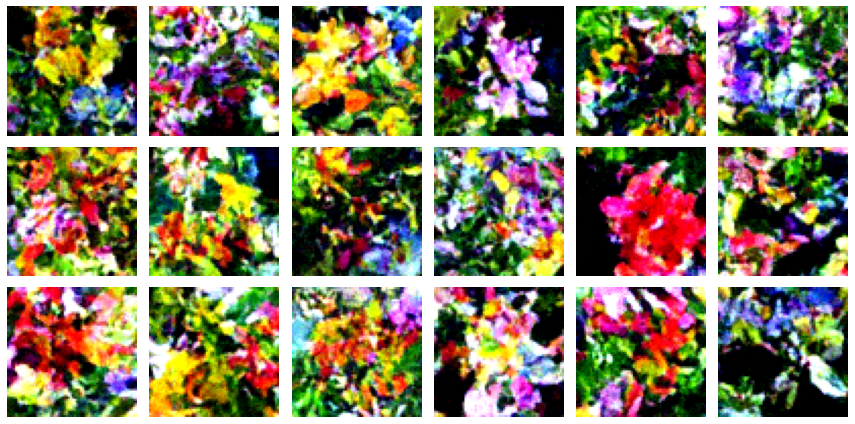

223/223 [==============================] - 423s 2s/step - n_loss: 0.1539 - i_loss: 0.2670 - val_n_loss: 0.1791 - val_i_loss: 0.3883 - val_kid: 0.9665
Epoch 19/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1526 - i_loss: 0.2619

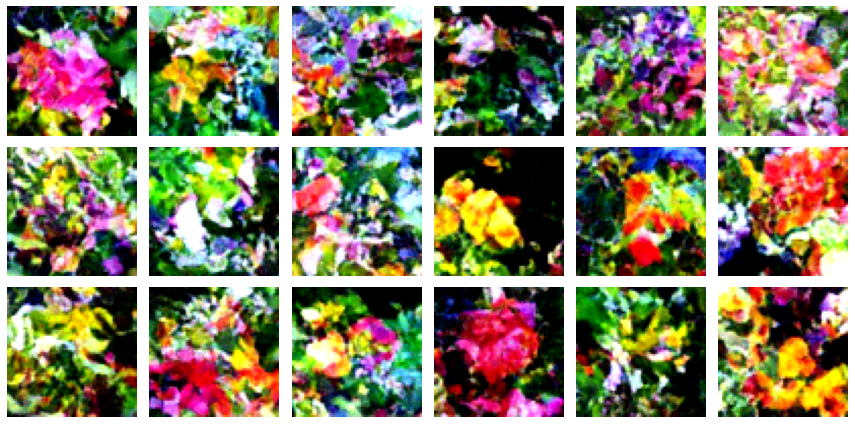

223/223 [==============================] - 421s 2s/step - n_loss: 0.1526 - i_loss: 0.2619 - val_n_loss: 0.1731 - val_i_loss: 0.3600 - val_kid: 0.8633
Epoch 20/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1526 - i_loss: 0.2613

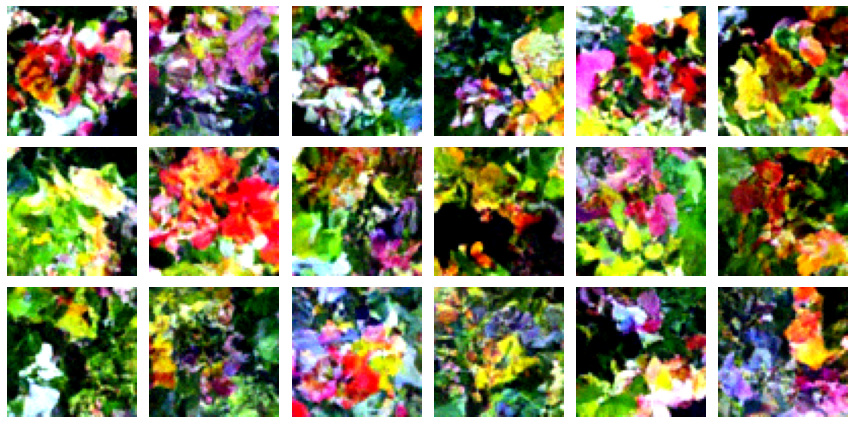

223/223 [==============================] - 422s 2s/step - n_loss: 0.1526 - i_loss: 0.2613 - val_n_loss: 0.1678 - val_i_loss: 0.3121 - val_kid: 0.8210
Epoch 21/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1533 - i_loss: 0.2614

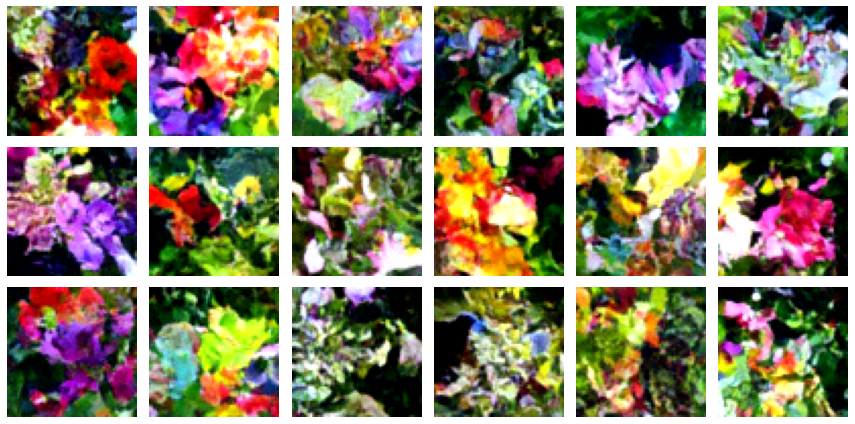

223/223 [==============================] - 425s 2s/step - n_loss: 0.1533 - i_loss: 0.2614 - val_n_loss: 0.1634 - val_i_loss: 0.2883 - val_kid: 0.8021
Epoch 22/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1531 - i_loss: 0.2589

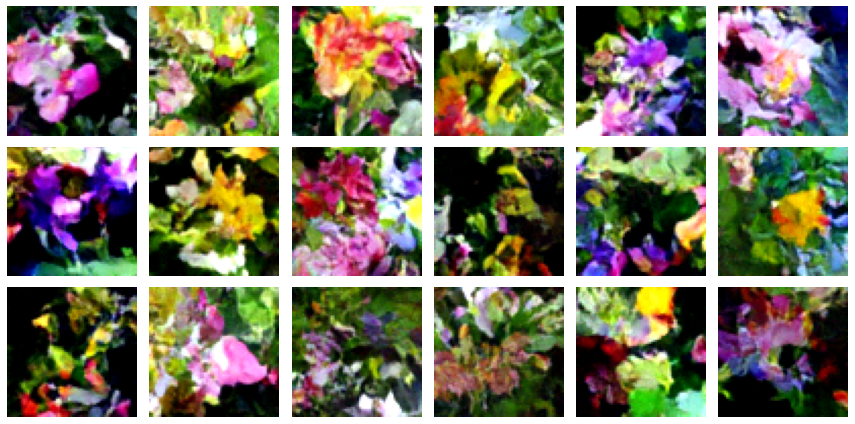

223/223 [==============================] - 423s 2s/step - n_loss: 0.1531 - i_loss: 0.2589 - val_n_loss: 0.1601 - val_i_loss: 0.2710 - val_kid: 0.7595
Epoch 23/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1531 - i_loss: 0.2609

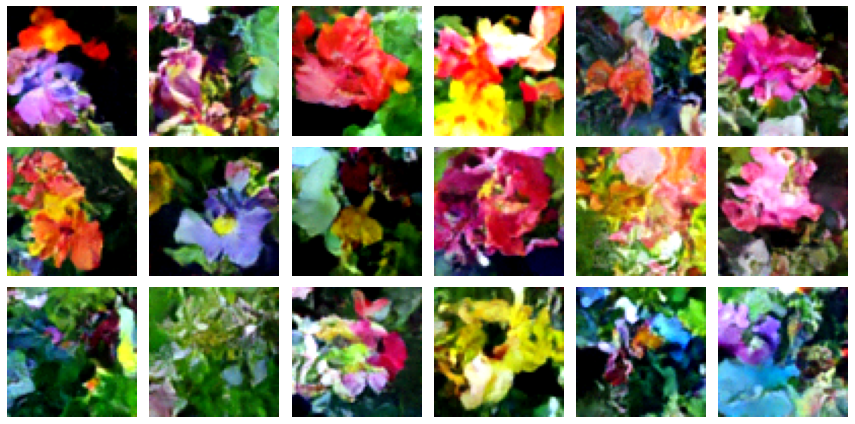

223/223 [==============================] - 424s 2s/step - n_loss: 0.1531 - i_loss: 0.2609 - val_n_loss: 0.1532 - val_i_loss: 0.2686 - val_kid: 0.7223
Epoch 24/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1540 - i_loss: 0.2538

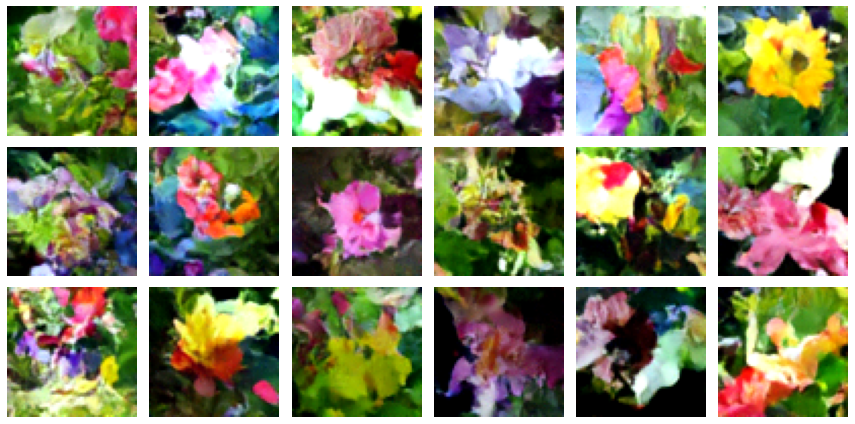

223/223 [==============================] - 425s 2s/step - n_loss: 0.1540 - i_loss: 0.2538 - val_n_loss: 0.1556 - val_i_loss: 0.2565 - val_kid: 0.6986
Epoch 25/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1527 - i_loss: 0.2548

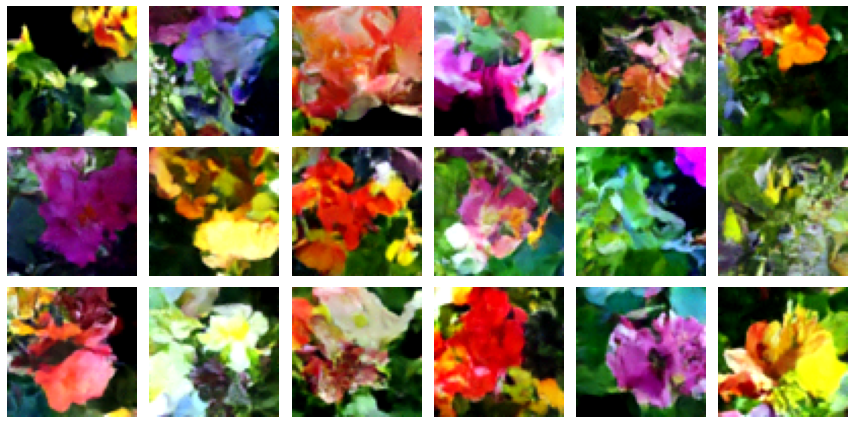

223/223 [==============================] - 422s 2s/step - n_loss: 0.1527 - i_loss: 0.2548 - val_n_loss: 0.1514 - val_i_loss: 0.2578 - val_kid: 0.6573
Epoch 26/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1519 - i_loss: 0.2581

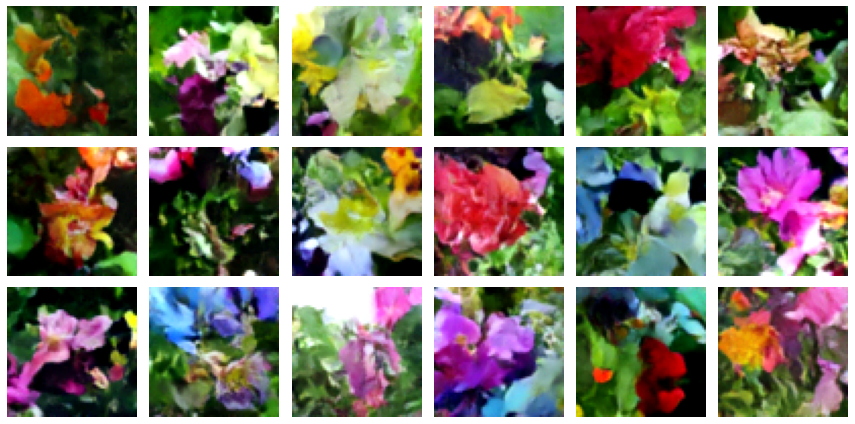

223/223 [==============================] - 421s 2s/step - n_loss: 0.1519 - i_loss: 0.2581 - val_n_loss: 0.1505 - val_i_loss: 0.2530 - val_kid: 0.6081
Epoch 27/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1505 - i_loss: 0.2579

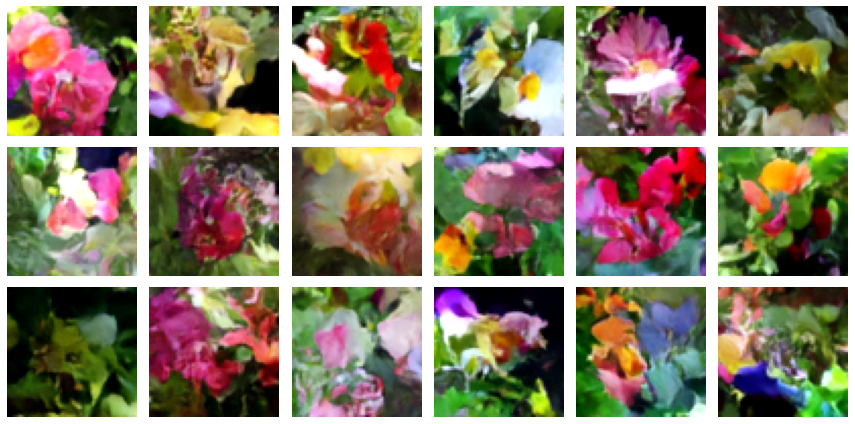

223/223 [==============================] - 426s 2s/step - n_loss: 0.1505 - i_loss: 0.2579 - val_n_loss: 0.1497 - val_i_loss: 0.2473 - val_kid: 0.5623
Epoch 28/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1532 - i_loss: 0.2562

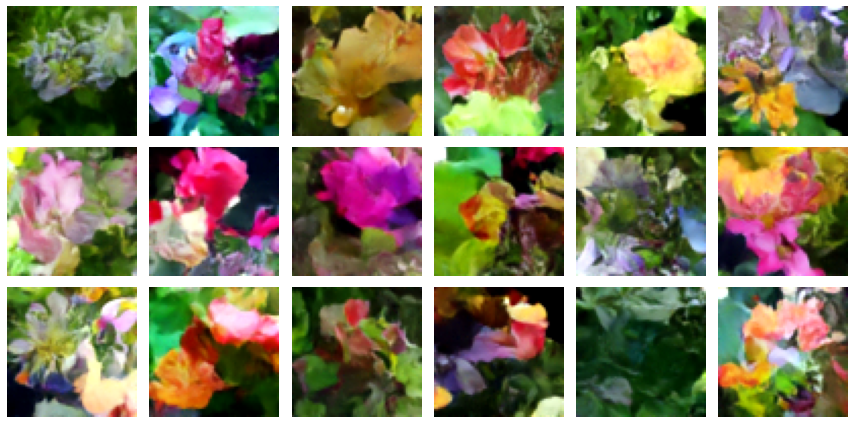

223/223 [==============================] - 419s 2s/step - n_loss: 0.1532 - i_loss: 0.2562 - val_n_loss: 0.1495 - val_i_loss: 0.2502 - val_kid: 0.5387
Epoch 29/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1513 - i_loss: 0.2560

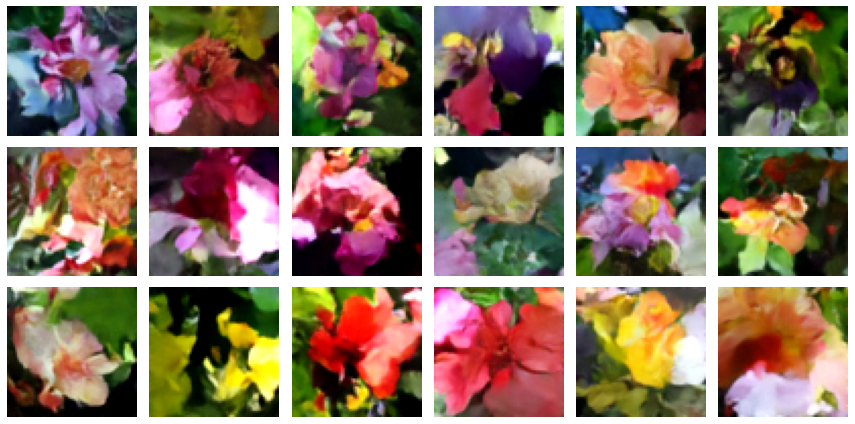

223/223 [==============================] - 423s 2s/step - n_loss: 0.1513 - i_loss: 0.2560 - val_n_loss: 0.1473 - val_i_loss: 0.2469 - val_kid: 0.5005
Epoch 30/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1527 - i_loss: 0.2548

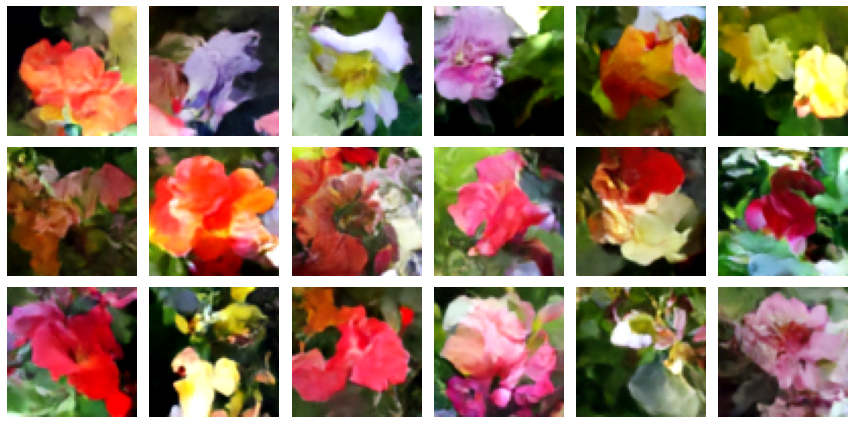

223/223 [==============================] - 420s 2s/step - n_loss: 0.1527 - i_loss: 0.2548 - val_n_loss: 0.1489 - val_i_loss: 0.2370 - val_kid: 0.4729
Epoch 31/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1518 - i_loss: 0.2519

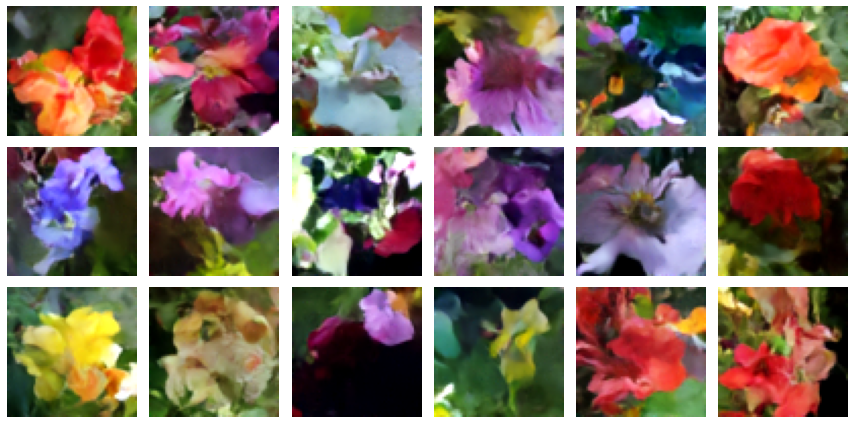

223/223 [==============================] - 420s 2s/step - n_loss: 0.1518 - i_loss: 0.2519 - val_n_loss: 0.1495 - val_i_loss: 0.2379 - val_kid: 0.4344
Epoch 32/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1512 - i_loss: 0.2540

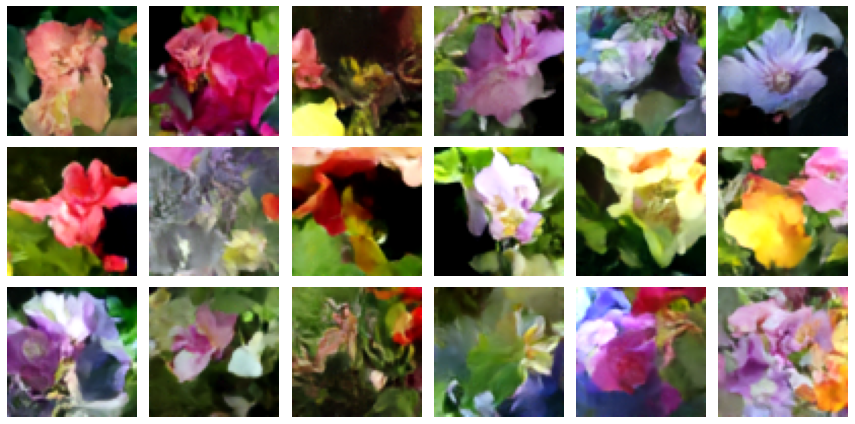

223/223 [==============================] - 420s 2s/step - n_loss: 0.1512 - i_loss: 0.2540 - val_n_loss: 0.1481 - val_i_loss: 0.2399 - val_kid: 0.4250
Epoch 33/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1513 - i_loss: 0.2557

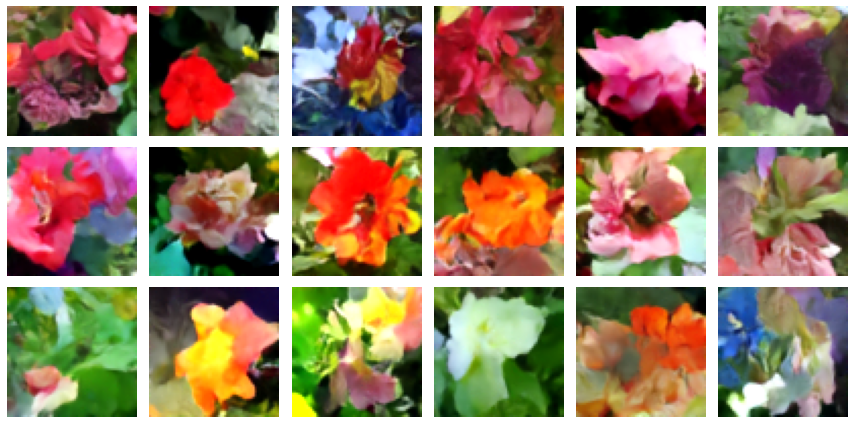

223/223 [==============================] - 420s 2s/step - n_loss: 0.1513 - i_loss: 0.2557 - val_n_loss: 0.1482 - val_i_loss: 0.2327 - val_kid: 0.4048
Epoch 34/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1502 - i_loss: 0.2526

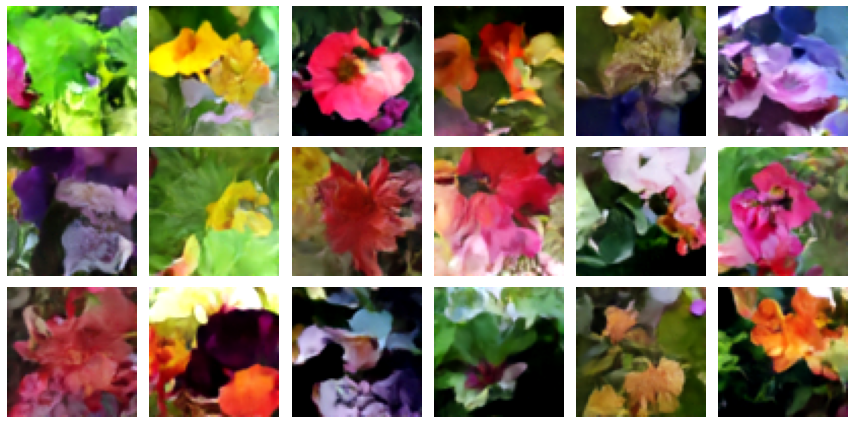

223/223 [==============================] - 416s 2s/step - n_loss: 0.1502 - i_loss: 0.2526 - val_n_loss: 0.1440 - val_i_loss: 0.2463 - val_kid: 0.3855
Epoch 35/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1506 - i_loss: 0.2563

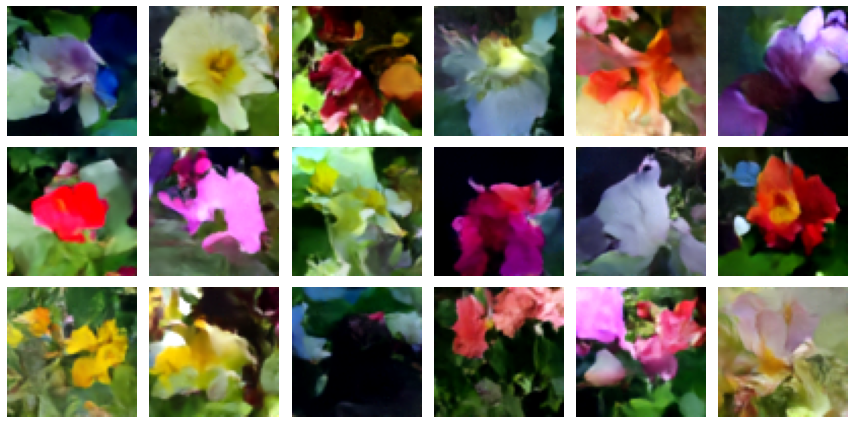

223/223 [==============================] - 416s 2s/step - n_loss: 0.1506 - i_loss: 0.2563 - val_n_loss: 0.1466 - val_i_loss: 0.2413 - val_kid: 0.4010
Epoch 36/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1498 - i_loss: 0.2533

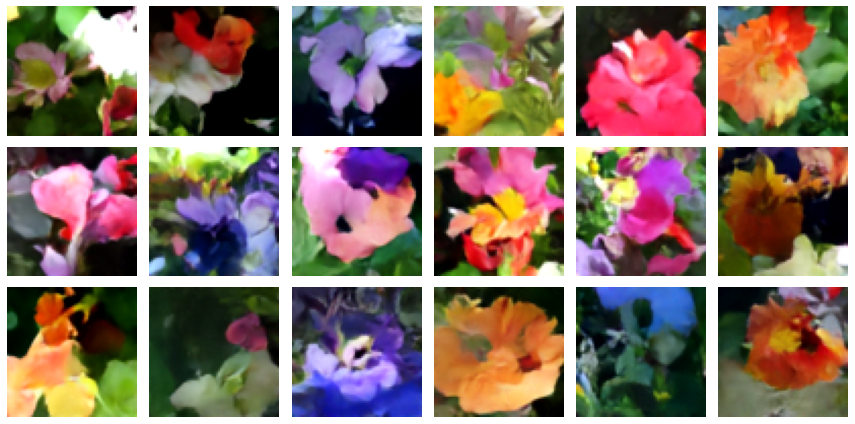

223/223 [==============================] - 422s 2s/step - n_loss: 0.1498 - i_loss: 0.2533 - val_n_loss: 0.1488 - val_i_loss: 0.2318 - val_kid: 0.3740
Epoch 37/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1509 - i_loss: 0.2484

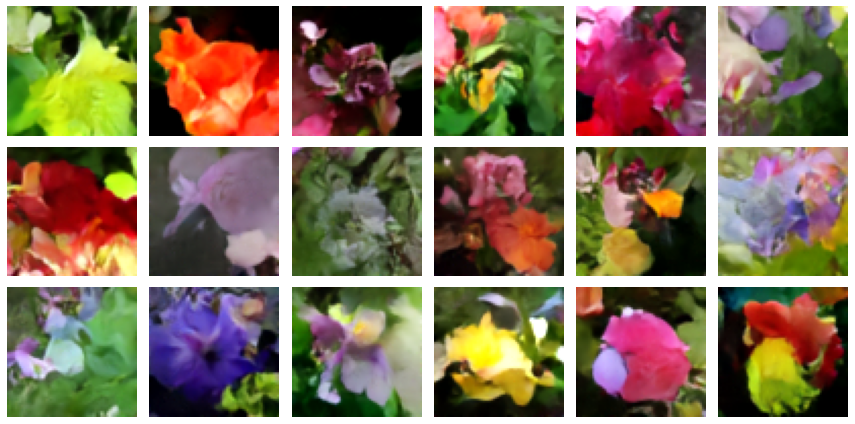

223/223 [==============================] - 421s 2s/step - n_loss: 0.1509 - i_loss: 0.2484 - val_n_loss: 0.1458 - val_i_loss: 0.2343 - val_kid: 0.3916
Epoch 38/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1492 - i_loss: 0.2523

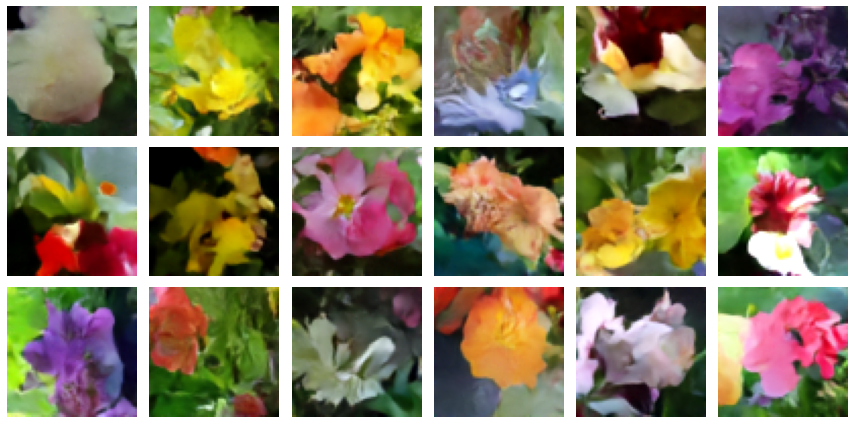

223/223 [==============================] - 422s 2s/step - n_loss: 0.1492 - i_loss: 0.2523 - val_n_loss: 0.1467 - val_i_loss: 0.2391 - val_kid: 0.3754
Epoch 39/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1498 - i_loss: 0.2533

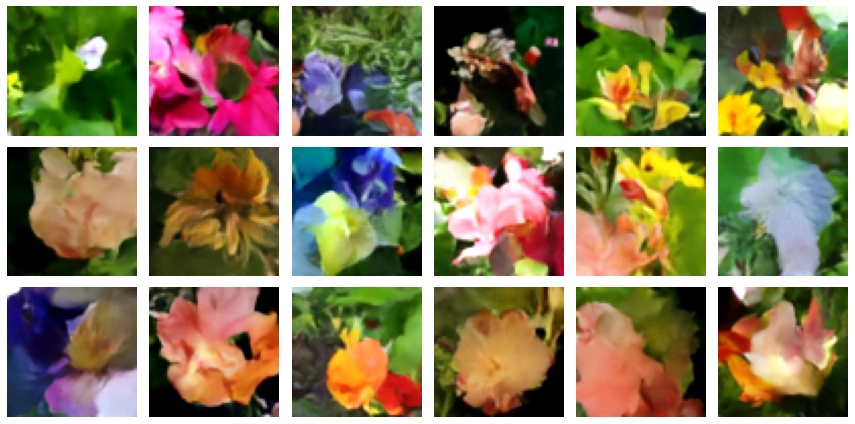

223/223 [==============================] - 427s 2s/step - n_loss: 0.1498 - i_loss: 0.2533 - val_n_loss: 0.1444 - val_i_loss: 0.2396 - val_kid: 0.3705
Epoch 40/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1508 - i_loss: 0.2535

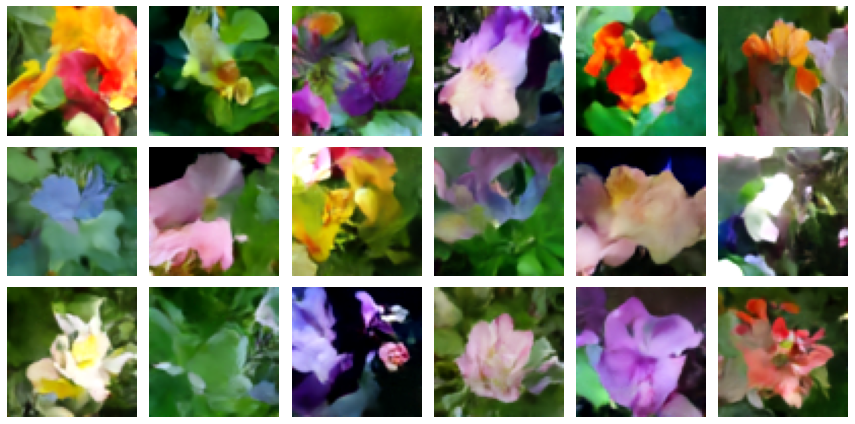

223/223 [==============================] - 427s 2s/step - n_loss: 0.1508 - i_loss: 0.2535 - val_n_loss: 0.1492 - val_i_loss: 0.2324 - val_kid: 0.3381
Epoch 41/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1489 - i_loss: 0.2536

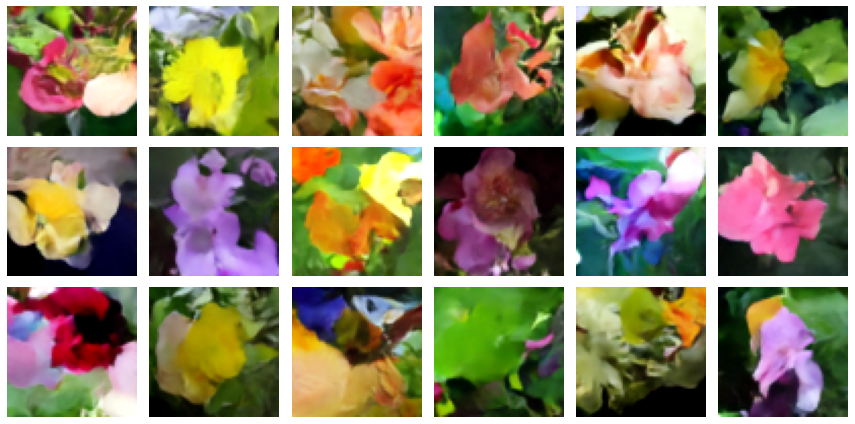

223/223 [==============================] - 429s 2s/step - n_loss: 0.1489 - i_loss: 0.2536 - val_n_loss: 0.1466 - val_i_loss: 0.2325 - val_kid: 0.3810
Epoch 42/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1504 - i_loss: 0.2496

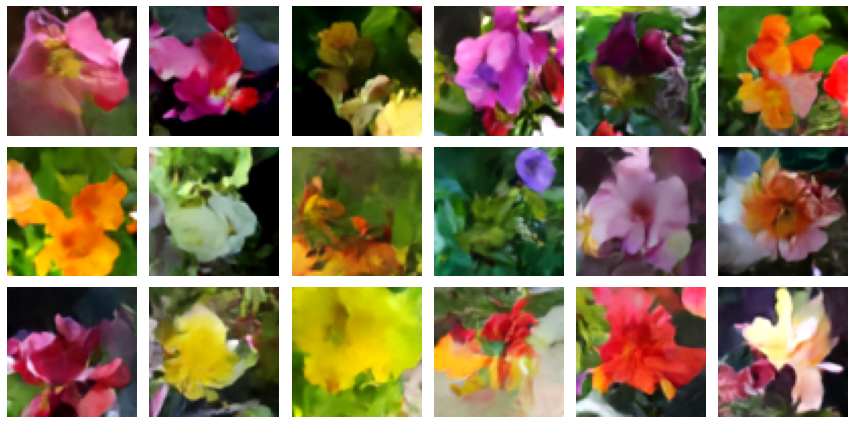

223/223 [==============================] - 434s 2s/step - n_loss: 0.1504 - i_loss: 0.2496 - val_n_loss: 0.1446 - val_i_loss: 0.2415 - val_kid: 0.3598
Epoch 43/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1502 - i_loss: 0.2528

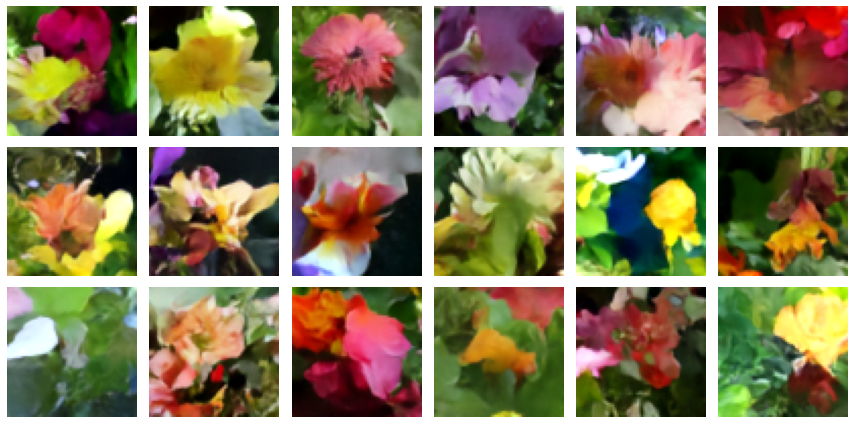

223/223 [==============================] - 429s 2s/step - n_loss: 0.1502 - i_loss: 0.2528 - val_n_loss: 0.1473 - val_i_loss: 0.2318 - val_kid: 0.3583
Epoch 44/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1484 - i_loss: 0.2521

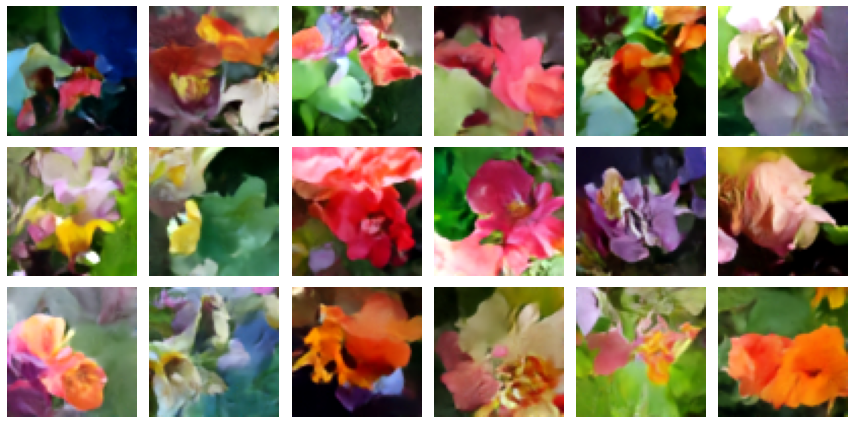

223/223 [==============================] - 431s 2s/step - n_loss: 0.1484 - i_loss: 0.2521 - val_n_loss: 0.1465 - val_i_loss: 0.2374 - val_kid: 0.3402
Epoch 45/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1498 - i_loss: 0.2497

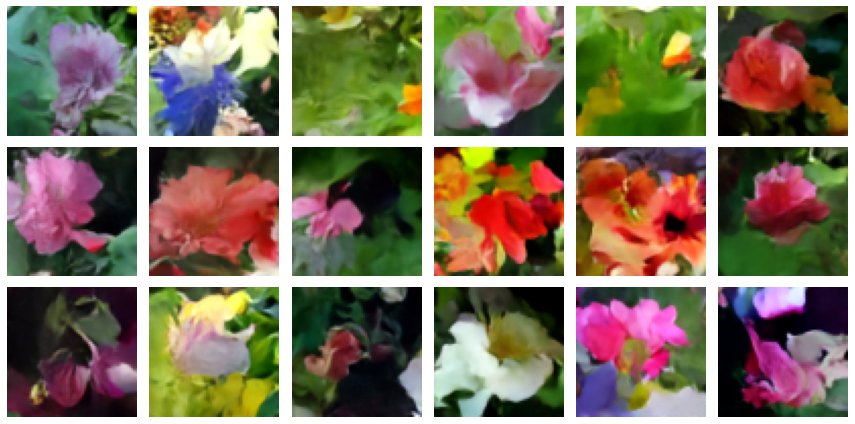

223/223 [==============================] - 430s 2s/step - n_loss: 0.1498 - i_loss: 0.2497 - val_n_loss: 0.1464 - val_i_loss: 0.2400 - val_kid: 0.3385
Epoch 46/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1498 - i_loss: 0.2521

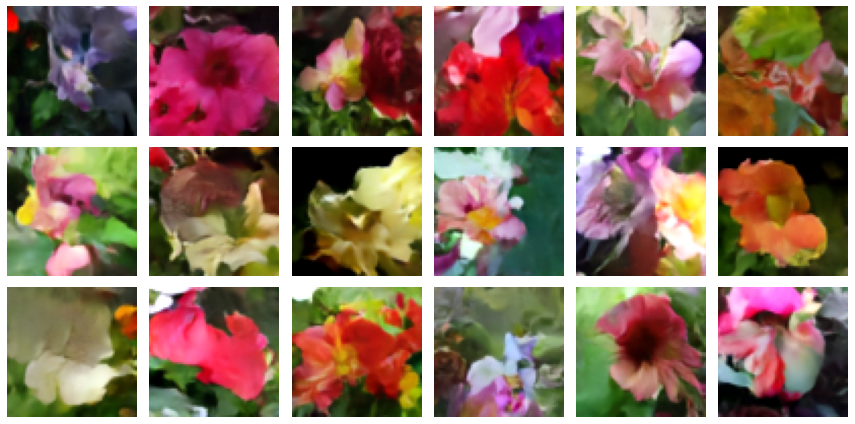

223/223 [==============================] - 502s 2s/step - n_loss: 0.1498 - i_loss: 0.2521 - val_n_loss: 0.1441 - val_i_loss: 0.2347 - val_kid: 0.3687
Epoch 47/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1488 - i_loss: 0.2503

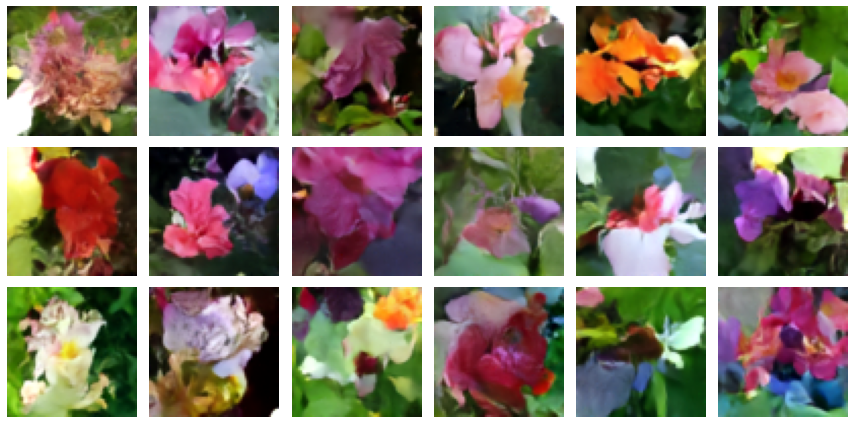

223/223 [==============================] - 553s 2s/step - n_loss: 0.1488 - i_loss: 0.2503 - val_n_loss: 0.1462 - val_i_loss: 0.2339 - val_kid: 0.3588
Epoch 48/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1485 - i_loss: 0.2523

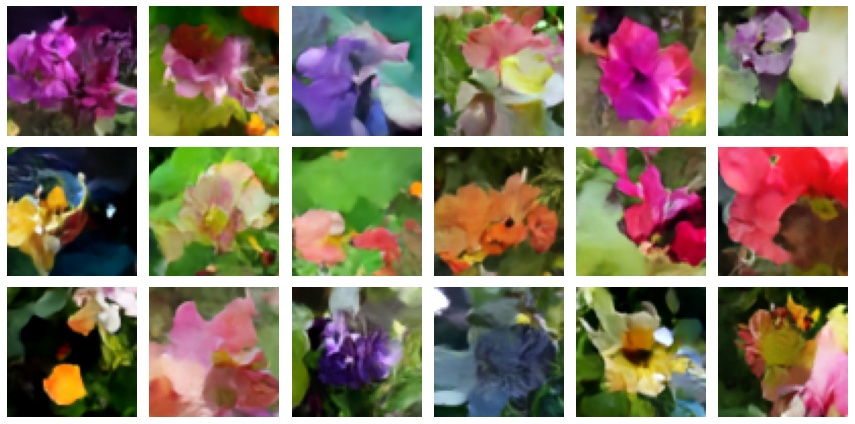

223/223 [==============================] - 576s 3s/step - n_loss: 0.1485 - i_loss: 0.2523 - val_n_loss: 0.1431 - val_i_loss: 0.2445 - val_kid: 0.3464
Epoch 49/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1505 - i_loss: 0.2488

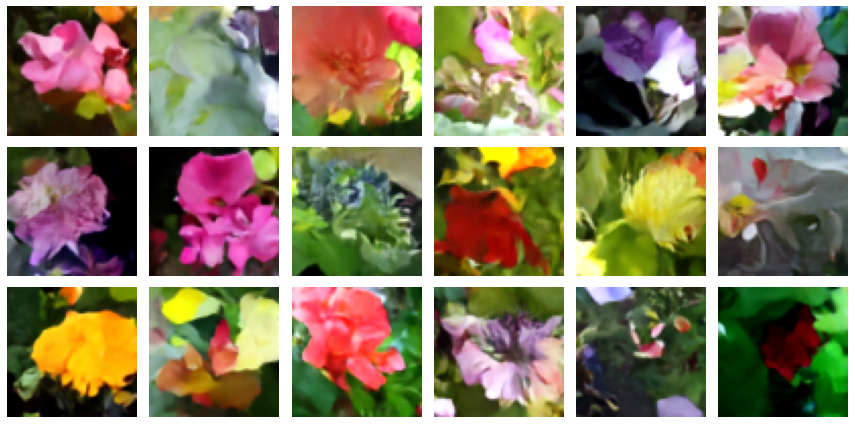

223/223 [==============================] - 599s 3s/step - n_loss: 0.1505 - i_loss: 0.2488 - val_n_loss: 0.1443 - val_i_loss: 0.2398 - val_kid: 0.3080
Epoch 50/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1489 - i_loss: 0.2488

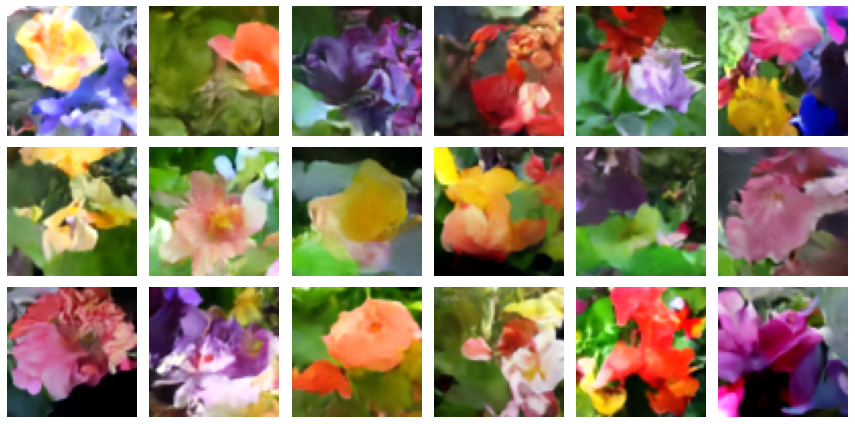

223/223 [==============================] - 597s 3s/step - n_loss: 0.1489 - i_loss: 0.2488 - val_n_loss: 0.1448 - val_i_loss: 0.2368 - val_kid: 0.3447
Epoch 51/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1501 - i_loss: 0.2463

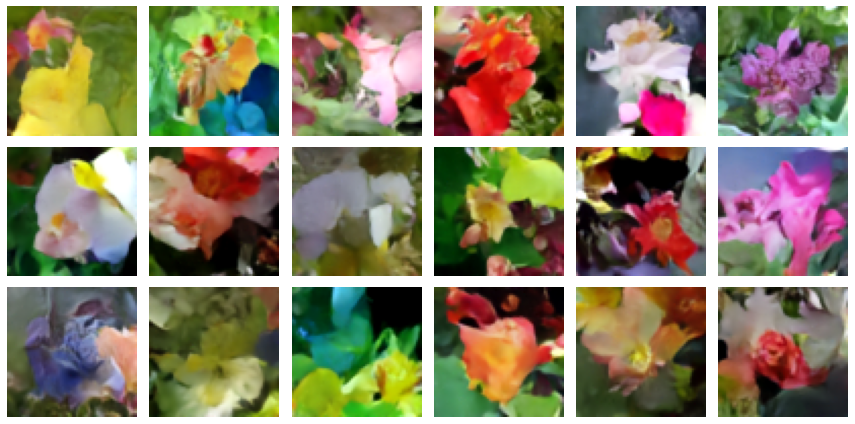

223/223 [==============================] - 600s 3s/step - n_loss: 0.1501 - i_loss: 0.2463 - val_n_loss: 0.1459 - val_i_loss: 0.2351 - val_kid: 0.3348
Epoch 52/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1489 - i_loss: 0.2499

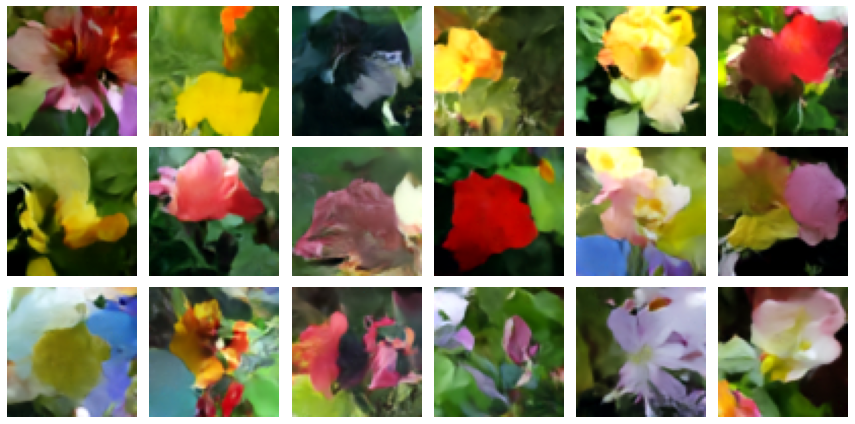

223/223 [==============================] - 602s 3s/step - n_loss: 0.1489 - i_loss: 0.2499 - val_n_loss: 0.1460 - val_i_loss: 0.2369 - val_kid: 0.3214
Epoch 53/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1488 - i_loss: 0.2529

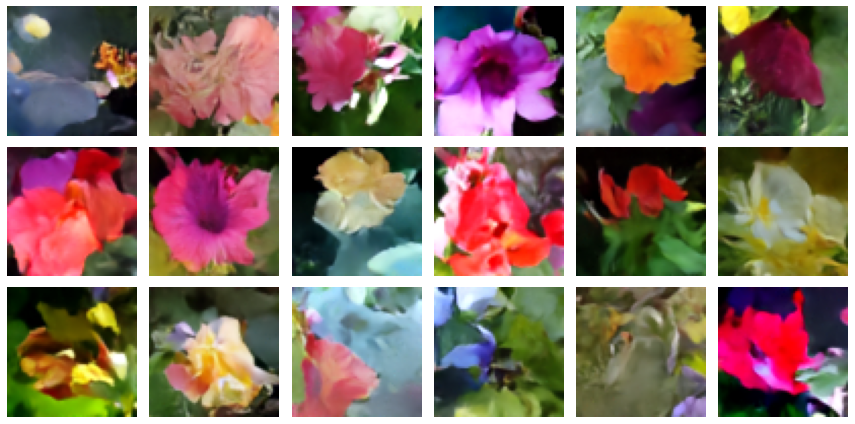

223/223 [==============================] - 601s 3s/step - n_loss: 0.1488 - i_loss: 0.2529 - val_n_loss: 0.1468 - val_i_loss: 0.2267 - val_kid: 0.3242
Epoch 54/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1487 - i_loss: 0.2501

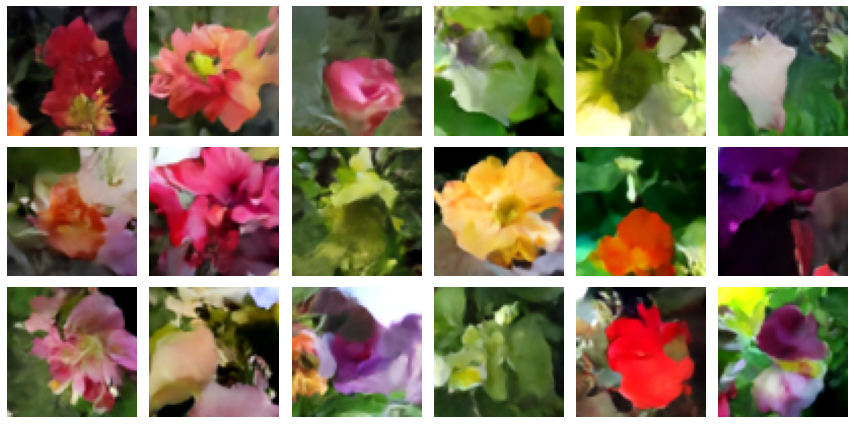

223/223 [==============================] - 591s 3s/step - n_loss: 0.1487 - i_loss: 0.2501 - val_n_loss: 0.1397 - val_i_loss: 0.2442 - val_kid: 0.3175
Epoch 55/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1489 - i_loss: 0.2507

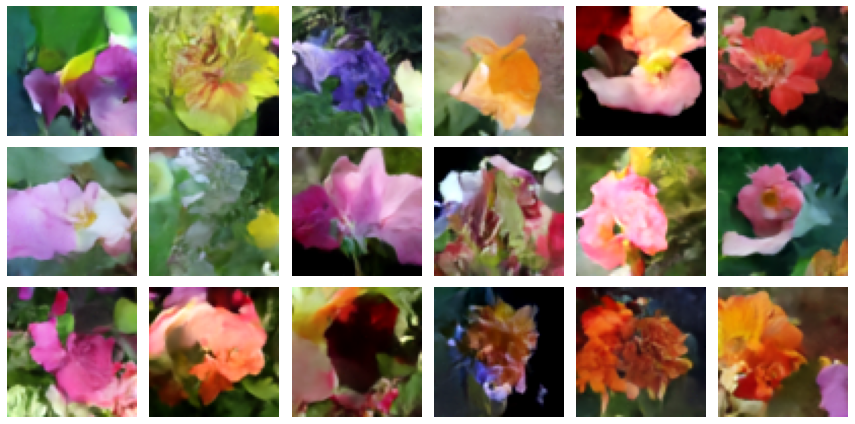

223/223 [==============================] - 604s 3s/step - n_loss: 0.1489 - i_loss: 0.2507 - val_n_loss: 0.1465 - val_i_loss: 0.2316 - val_kid: 0.3285
Epoch 56/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1495 - i_loss: 0.2512

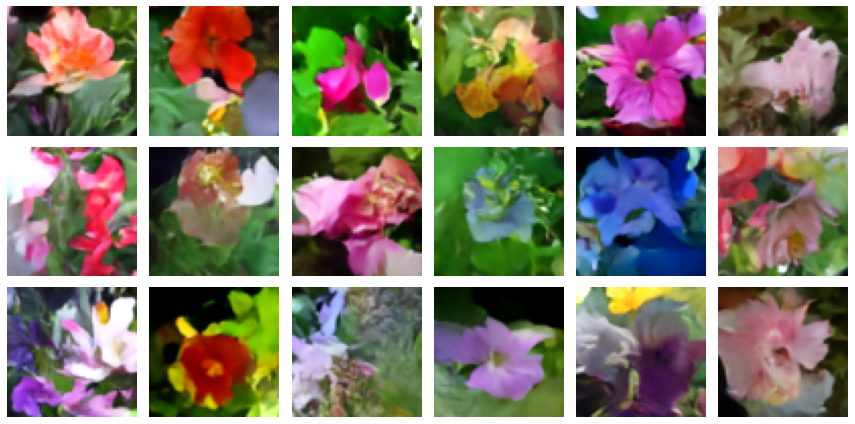

223/223 [==============================] - 603s 3s/step - n_loss: 0.1495 - i_loss: 0.2512 - val_n_loss: 0.1471 - val_i_loss: 0.2344 - val_kid: 0.3252
Epoch 57/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1481 - i_loss: 0.2503

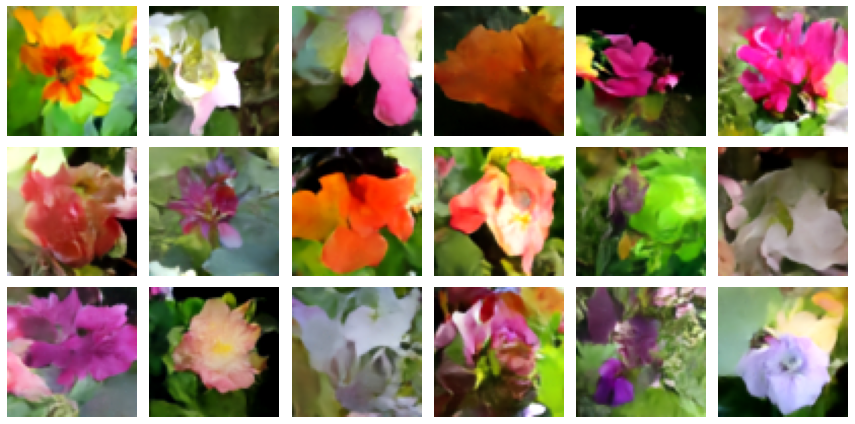

223/223 [==============================] - 607s 3s/step - n_loss: 0.1481 - i_loss: 0.2503 - val_n_loss: 0.1434 - val_i_loss: 0.2357 - val_kid: 0.3112
Epoch 58/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1491 - i_loss: 0.2481

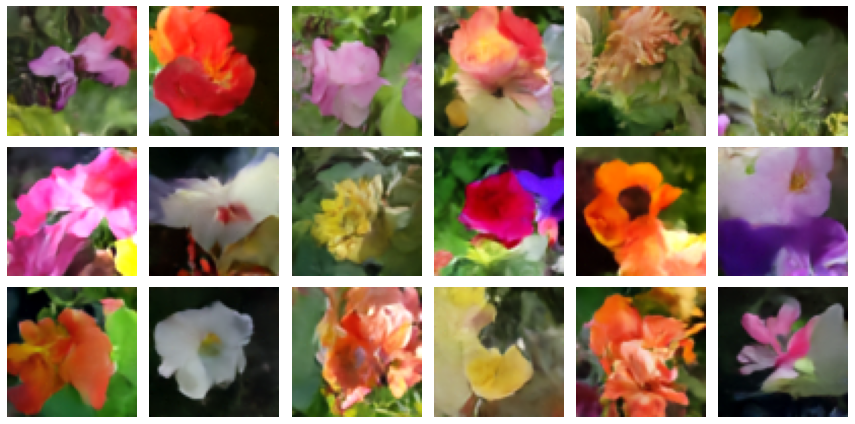

223/223 [==============================] - 608s 3s/step - n_loss: 0.1491 - i_loss: 0.2481 - val_n_loss: 0.1442 - val_i_loss: 0.2339 - val_kid: 0.3214
Epoch 59/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1492 - i_loss: 0.2525

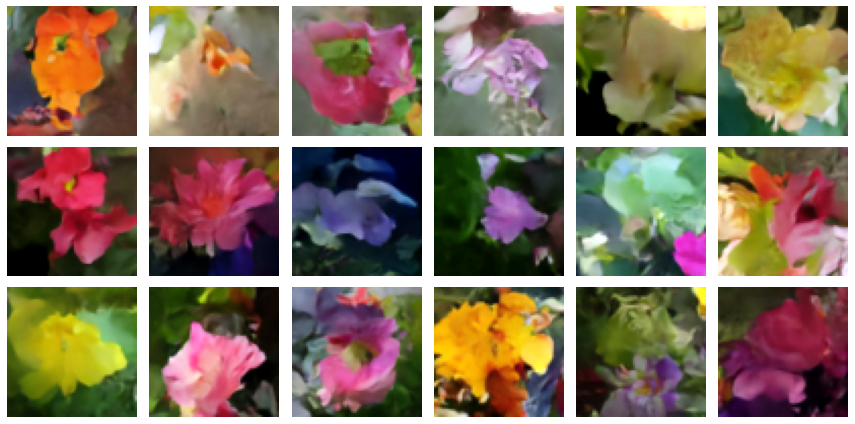

223/223 [==============================] - 602s 3s/step - n_loss: 0.1492 - i_loss: 0.2525 - val_n_loss: 0.1442 - val_i_loss: 0.2319 - val_kid: 0.3224
Epoch 60/60
223/223 [==============================] - ETA: 0s - n_loss: 0.1480 - i_loss: 0.2495

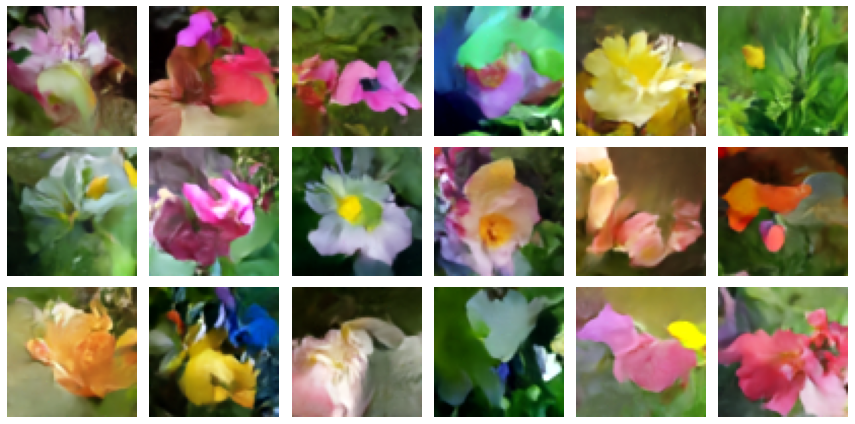

223/223 [==============================] - 613s 3s/step - n_loss: 0.1480 - i_loss: 0.2495 - val_n_loss: 0.1449 - val_i_loss: 0.2342 - val_kid: 0.3300


In [24]:
# run training and plot generated images periodically
model.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=num_epochs,
    callbacks=[
        keras.callbacks.LambdaCallback(on_epoch_end = model.plot_images ),
        checkpoint_callback,
    ],
)

## Inference

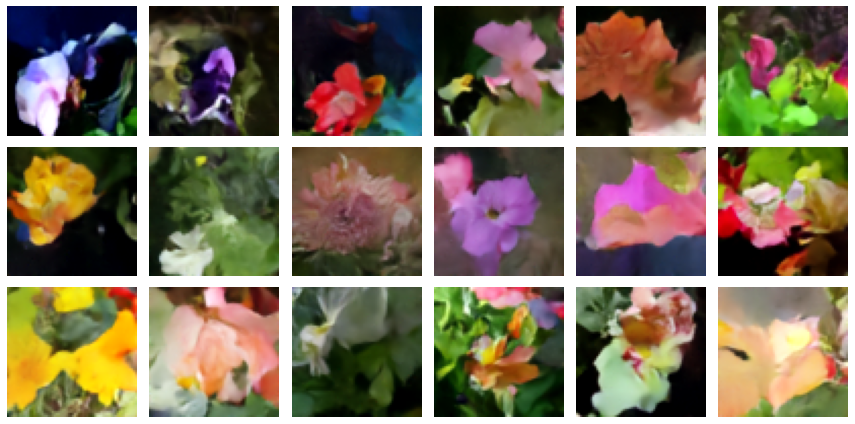

In [25]:
# load the best model and generate images
model.load_weights(checkpoint_path)
model.plot_images()

## Summary
In this implementation, we completed the core components of the diffusion process:
1.	diffusion_schedule:
	We implemented a cosine schedule to calculate the signal and noise rates for each timestep in the diffusion process. This ensures a smooth transition between pure noise and reconstructed signals, with the squared sum of the rates maintaining consistency as  $\sin^2(x) + \cos^2(x) = 1 $.
2.	denoise:
	We developed the denoising function, which uses the trained network to predict the noise component in the input noisy images. Using the predicted noise and known signal rates, we calculated the clean image components.
3.	reverse_diffusion:
	This is the key process for sampling, where we iteratively reverse the forward diffusion process. Starting from pure noise, the model progressively reconstructs cleaner images by combining the predicted noise and image components using calculated signal and noise rates.